In [12]:
from doctr.io import DocumentFile
from doctr.models import ocr_predictor

In [2]:
import json

In [3]:

#initializing a pre-trained OCR model
model = ocr_predictor(pretrained=True)


In [4]:
#loading PDF
doc = DocumentFile.from_pdf("U11BBFK1105_94e16f81-f984-40be-b8a9-a2b4454c1ceb.pdf")



In [5]:
# Analysis
result = model(doc)


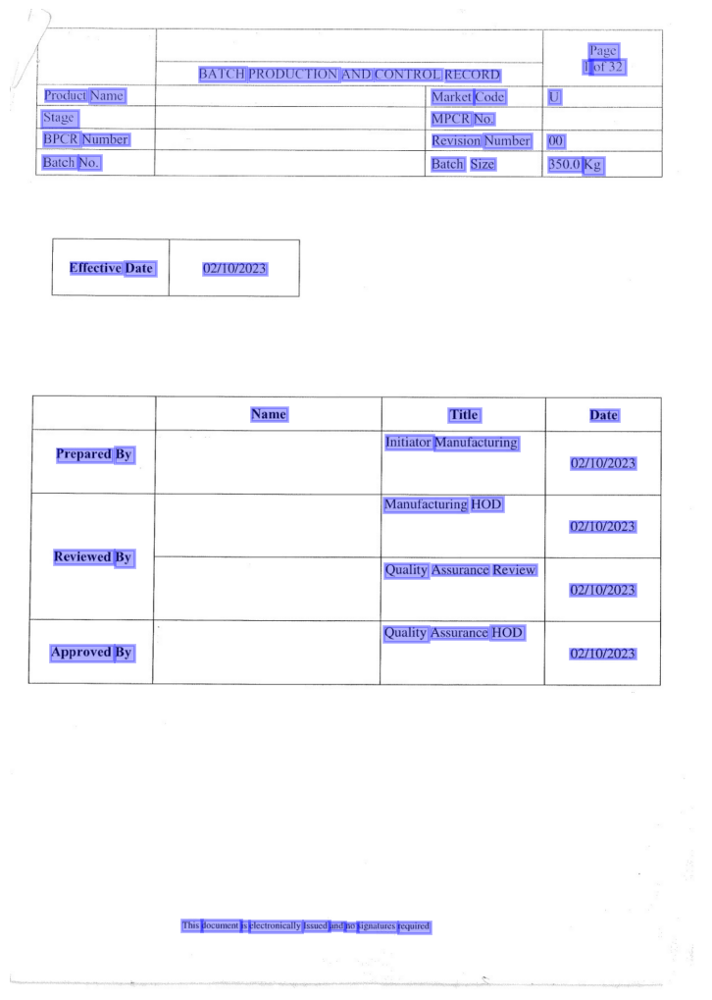

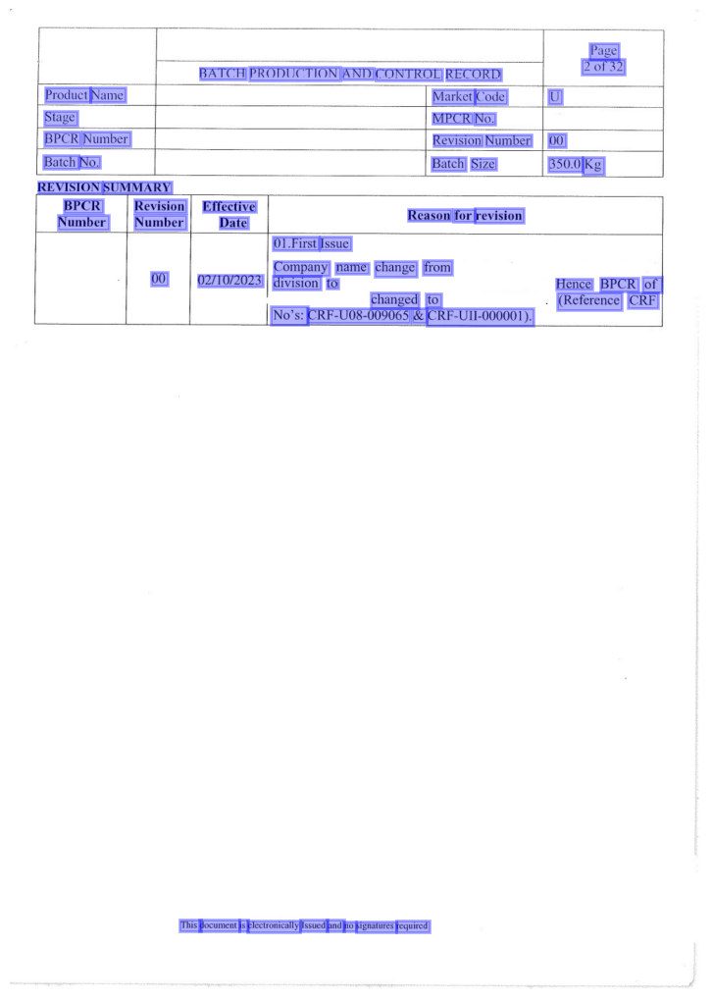

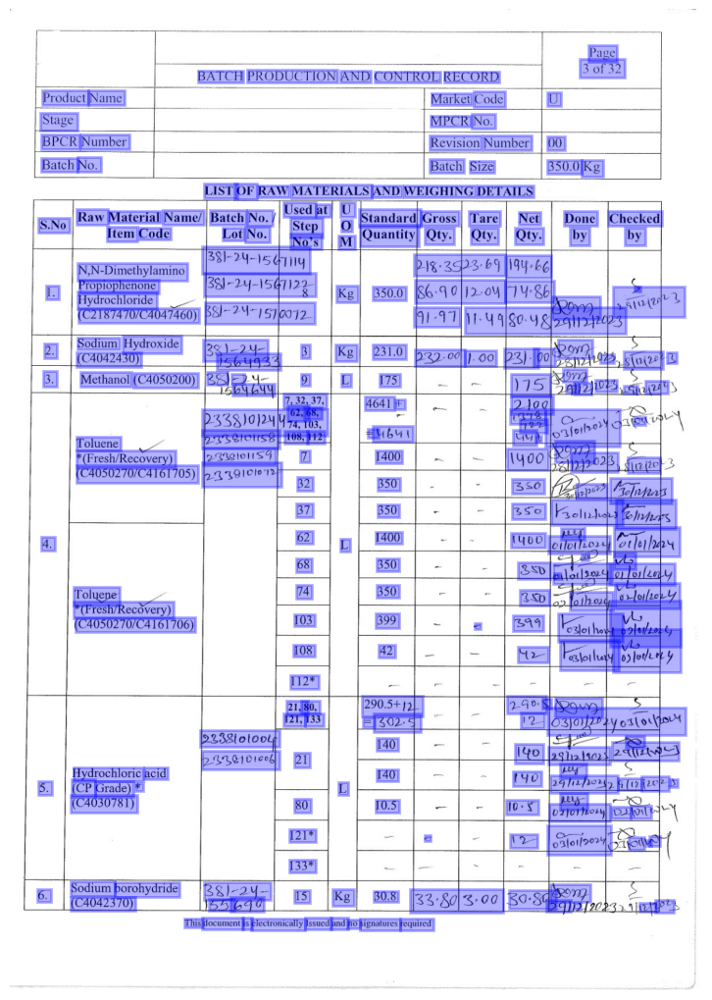

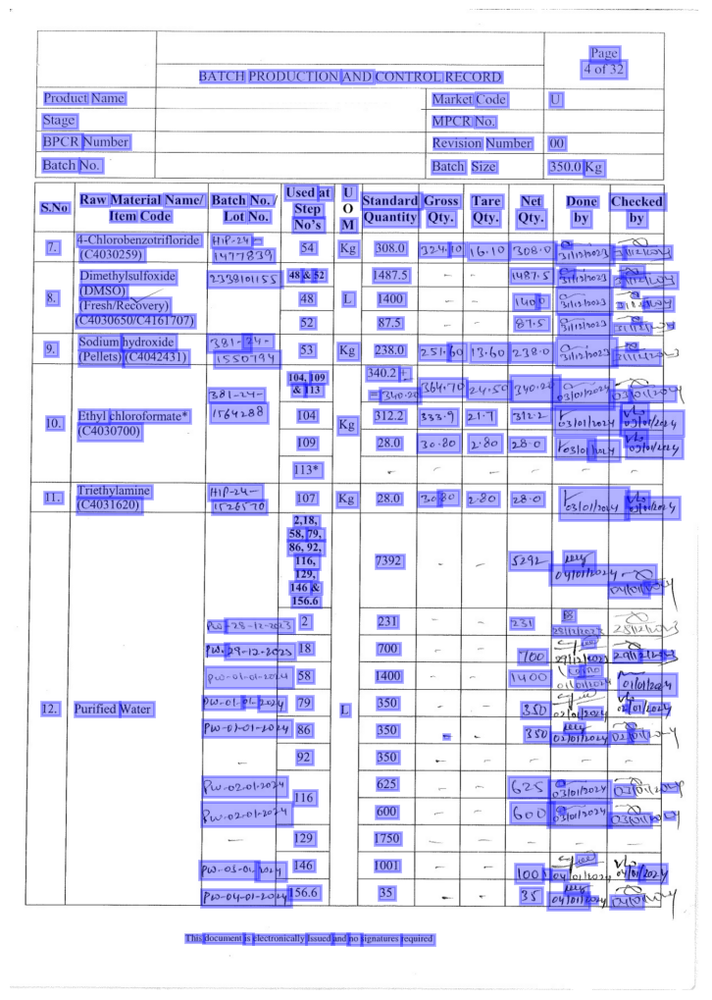

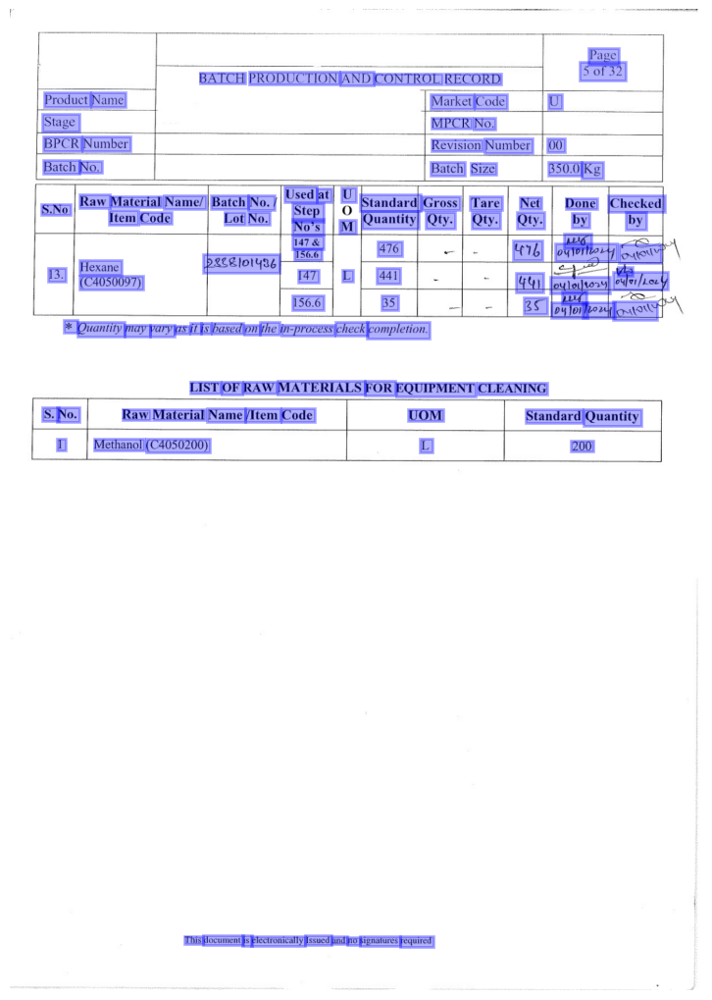

...

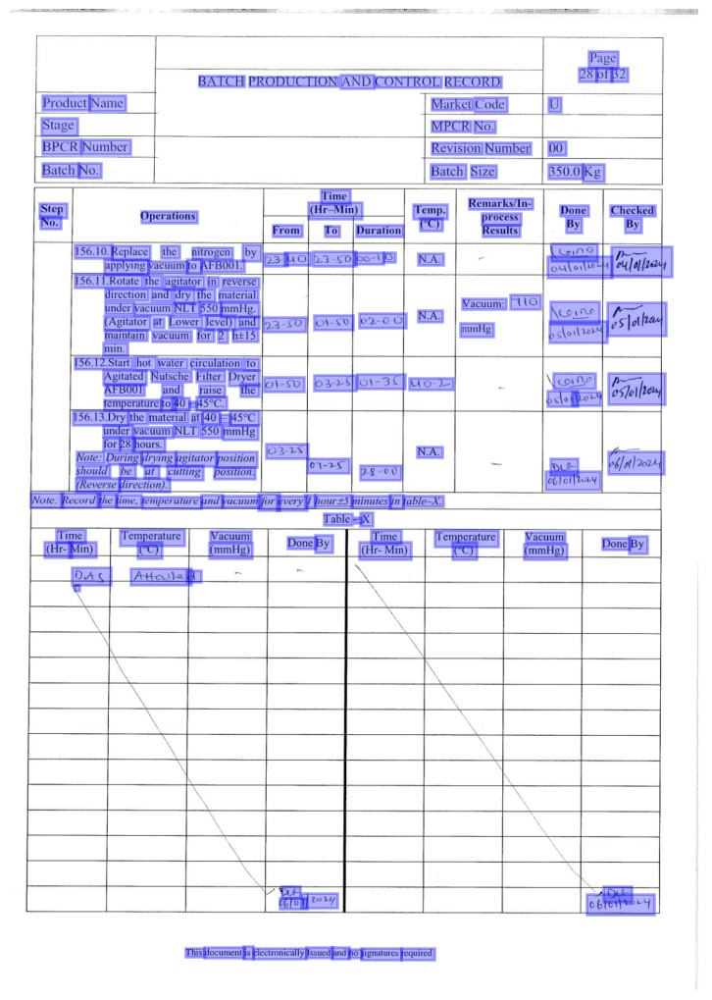

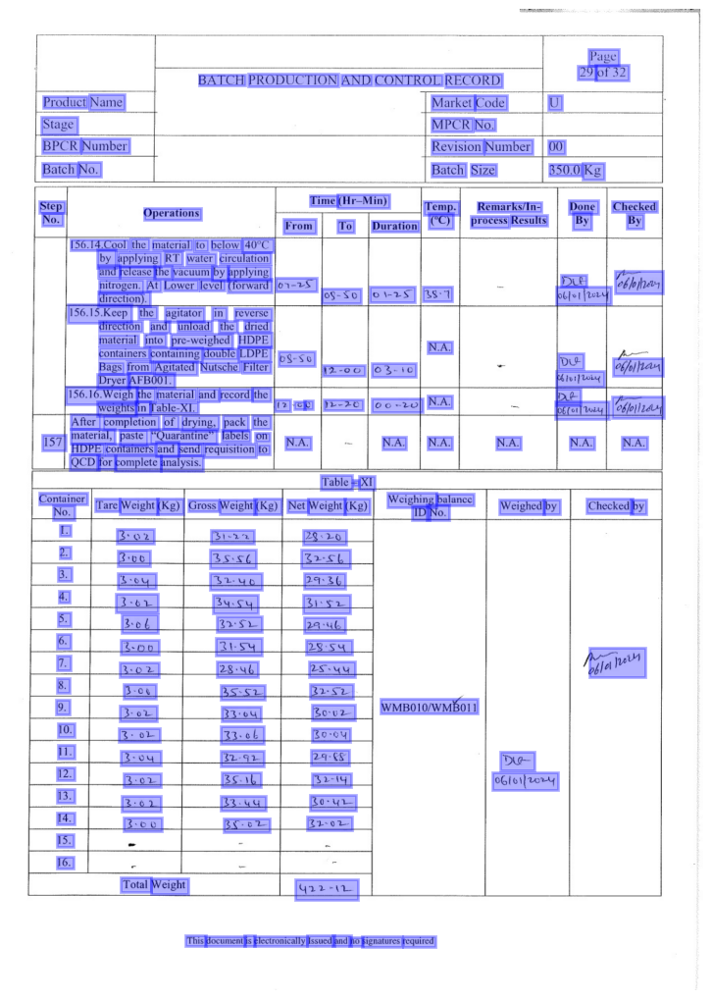

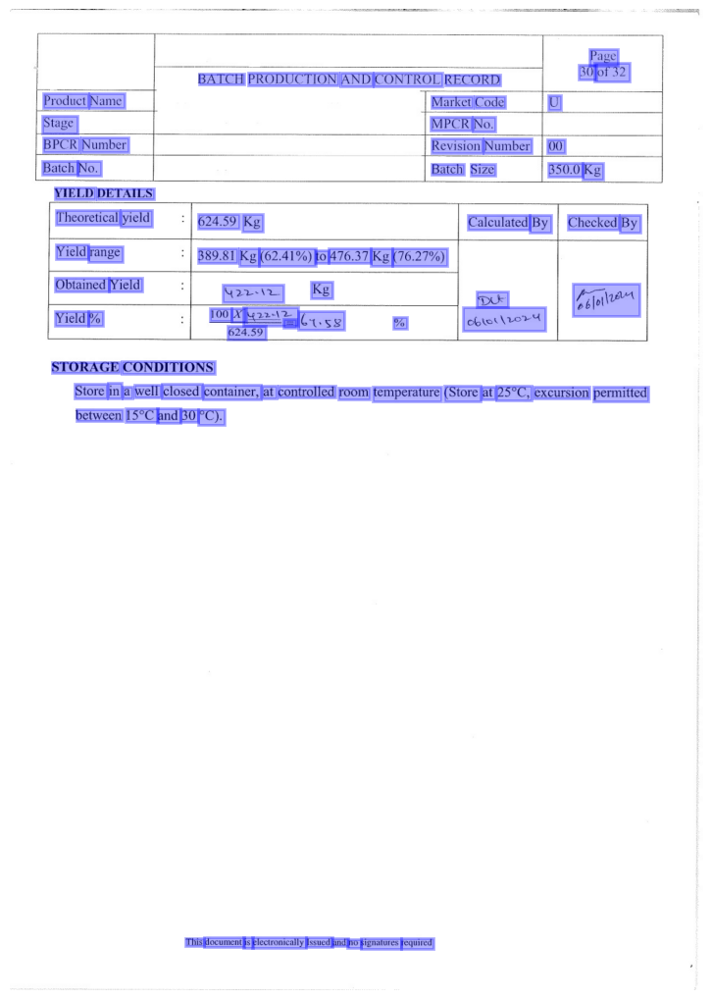

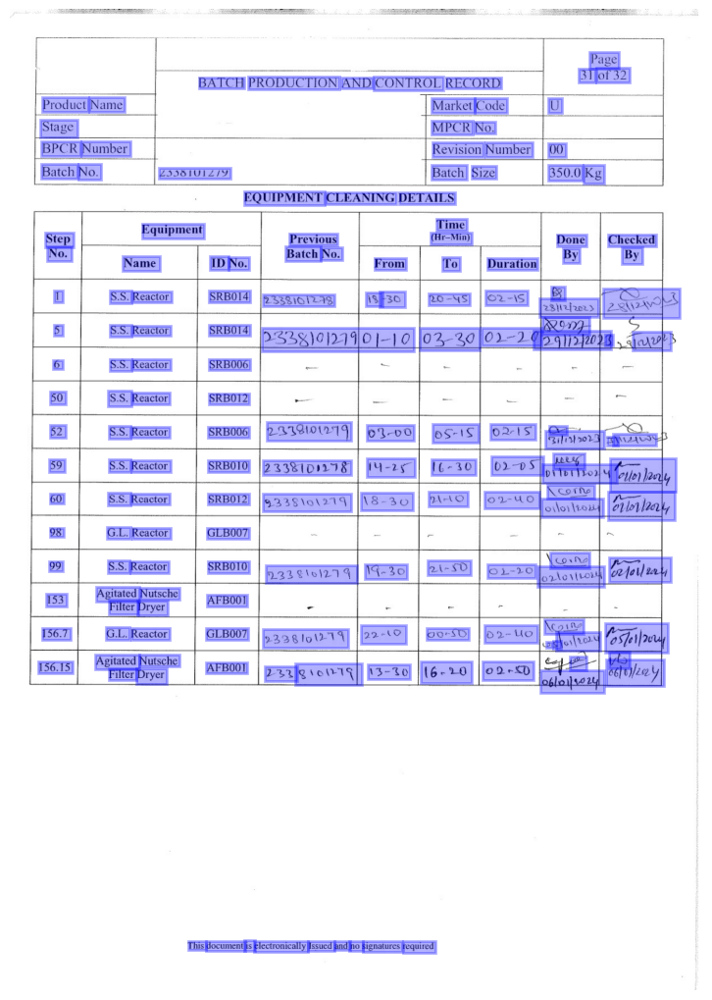

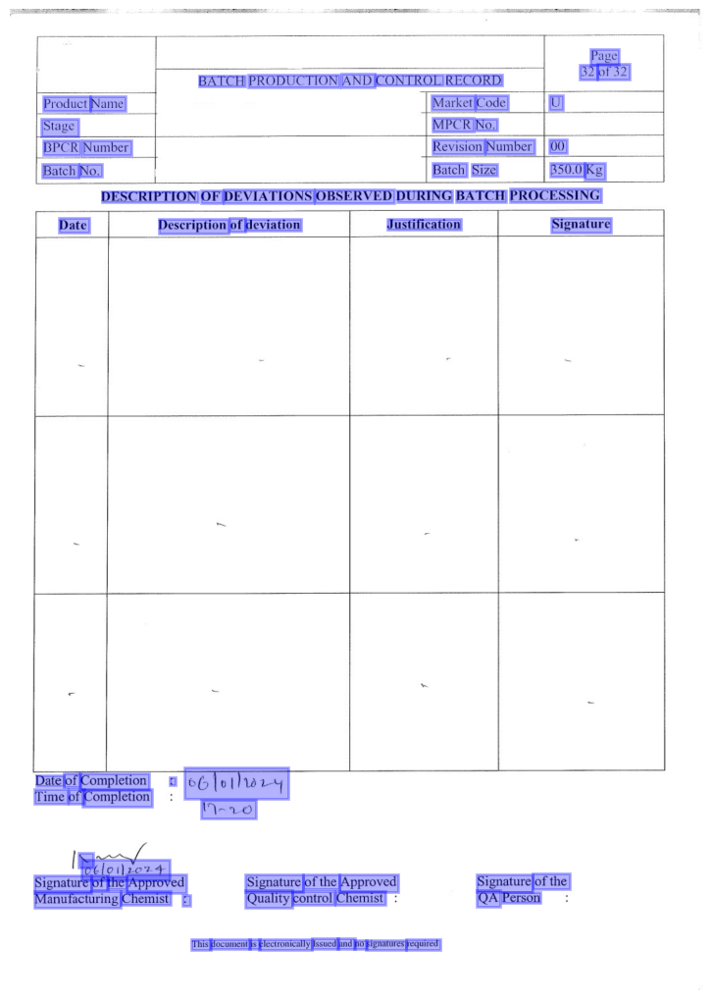

In [6]:
result.show()

In [7]:
print('Result : \n', result)

Result : 
 Document(
  (pages): [
    Page(
      dimensions=(1685, 1191)
      (blocks): [
        Block(
          (lines): [
            Line(
              (words): [Word(value='Page', confidence=0.89)]
            ),
            Line(
              (words): [
                Word(value='1', confidence=0.84),
                Word(value='of32', confidence=1.0),
              ]
            ),
          ]
          (artefacts): []
        ),
        Block(
          (lines): [Line(
            (words): [
              Word(value='BATCH', confidence=1.0),
              Word(value='PRODUCTION', confidence=0.98),
              Word(value='AND', confidence=0.99),
              Word(value='CONTROL', confidence=0.99),
              Word(value='RECORD', confidence=1.0),
            ]
          )]
          (artefacts): []
        ),
        Block(
          (lines): [
            Line(
              (words): [
                Word(value='Product', confidence=1.0),
                Word(value=

In [8]:
json_response = result.export()

In [9]:
json_response

{'pages': [{'page_idx': 0,
   'dimensions': (1685, 1191),
   'orientation': {'value': None, 'confidence': None},
   'language': {'value': None, 'confidence': None},
   'blocks': [{'geometry': ((0.8260620014693535, 0.03515625),
      (0.8882348407325777, 0.06640625)),
     'lines': [{'geometry': ((0.8343517133711167, 0.03515625),
        (0.8785635101805206, 0.0517578125)),
       'words': [{'value': 'Page',
         'confidence': 0.8935140371322632,
         'geometry': ((0.8343517133711167, 0.03515625),
          (0.8785635101805206, 0.0517578125))}]},
      {'geometry': ((0.8260620014693535, 0.05078125),
        (0.8882348407325777, 0.06640625)),
       'words': [{'value': '1',
         'confidence': 0.8441308736801147,
         'geometry': ((0.8260620014693535, 0.0517578125),
          (0.8398781879722922, 0.0654296875))},
        {'value': 'of32',
         'confidence': 0.998687207698822,
         'geometry': ((0.8357333320214106, 0.05078125),
          (0.8882348407325777, 0.06640

In [10]:
data = json_response

In [11]:
# Function to extract words
def extract_words(data):
    words = []
    for page in data["pages"]:
        for block in page["blocks"]:
            for line in block["lines"]:
                for word in line["words"]:
                    words.append(word["value"])
    return words

# Extract words from the JSON data
extracted_words = extract_words(data)
print(extracted_words)

['Page', '1', 'of32', 'BATCH', 'PRODUCTION', 'AND', 'CONTROL', 'RECORD', 'Product', 'Name', 'Stage', 'BPCR', 'Number', 'Batch', 'No.', 'Market', 'Code', 'MPCR', 'No.', 'Revision', 'Number', '00', 'Batch', 'Size', 'U', '350.0', 'Kg', 'Effective', 'Date', '02/10/2023', 'Name', 'Title', 'Date', '02/10/2023', 'Initiator', 'Manufacturing', 'Manufacturing', 'HOD', 'Prepared', 'By', '02/10/2023', 'Reviewed', 'By', 'Quality', 'Assurance', 'Review', 'Quality', 'Assurance', 'HOD', '02/10/2023', 'Approved', 'By', '02/10/2023', 'This', 'document', 'is', 'electronically', 'Issued', 'and', 'no', 'signatures', 'required', 'Page', '2of32', 'BATCH', 'PRODUCTION', 'AND', 'CONTROL', 'RECORD', 'Product', 'Name', 'Stage', 'BPCR', 'Number', 'Batch', 'No.', 'REVISION', 'SUMMARY', 'BPCR', 'Number', 'Market', 'Code', 'MPCR', 'No.', 'Revision', 'Number', '00', 'Batch', 'Size', 'Reason', 'for', 'revision', 'U', '350.0', 'Kg', 'Revision', 'Effective', 'Number', '00', 'Date', '01.First', 'Issue', 'Company', 'name'

In [ ]:
# Function to save words to a text file
def save_words_to_file(words, filename):
    with open(filename, 'w') as f:
        for word in words:
            f.write(word + '\n')

# Extract words from the JSON data
extracted_words = extract_words(data)

# Save extracted words to a text file
save_words_to_file(extracted_words, 'extracted_words.txt')

In [13]:
import matplotlib.pyplot as plt

In [ ]:
# synthetic_pages = result.synthesize()
# plt.imshow(synthetic_pages[0]); 
# plt.axis('off'); 
# plt.show()

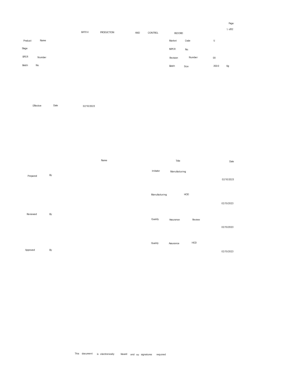

In [20]:
synthetic_pages = result.synthesize()

In [36]:
plt.figure(figsize=(200, 160))

# Display 5 synthetic pages
for i in range(5):
    plt.subplot(1, 5, i + 1)
    plt.imshow(synthetic_pages[i])
    plt.axis('off')

# # Show the images
# plt.show()

In [46]:
from PIL import Image
import numpy as np
import os

In [51]:
# Create a folder to save the synthetic pages if it doesn't exist
folder_name = "synthetic_pages"
os.makedirs(folder_name, exist_ok=True)

In [56]:


# Save each synthetic page with its page number
for i, page in enumerate(synthetic_pages):
    filename = os.path.join(folder_name, f"page_{i+1}.png")
    
    # Convert numpy array to PIL Image
    image_pil = Image.fromarray(np.uint8(page))
    
    # Resize the image
    resized_image = image_pil.resize((2480, 3508))
    
    # Save the resized image
    resized_image.save(filename)

print("Synthetic pages saved in folder:", folder_name)

Synthetic pages saved in folder: synthetic_pages
